Music Generation with RNNs

In [0]:
# Import Tensorflow 2.0
%tensorflow_version 2.x
import tensorflow as tf 

# Download and import the MIT 6.S191 package
!pip install mitdeeplearning
import mitdeeplearning as mdl

# Import all remaining packages
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

# Check that we are using a GPU, if not switch runtimes
#   using Runtime > Change Runtime Type > GPU
assert len(tf.config.list_physical_devices('GPU')) > 0

TensorFlow 2.x selected.
     |████████████████████████████████| 2.1MB 2.9MB/s 
  Created wheel for mitdeeplearning: filename=mitdeeplearning-0.1.2-cp36-none-any.whl size=2114586 sha256=7d7d5eb11fff6d341322cdbdd8f8901aa2573fa82deb52106a5e285effccc754
  Stored in directory: /root/.cache/pip/wheels/27/e1/73/5f01c787621d8a3c857f59876c79e304b9b64db9ff5bd61b74
Successfully built mitdeeplearning



### Dataset contains thousands of Irish folk songs, represented in the ABC notation:


In [0]:
# Download the dataset
songs = mdl.lab1.load_training_data()

# Print one of the songs to inspect it in greater detail!
example_song = songs[0]
print("\nExample song: ")
print(example_song)

Found 816 songs in text

Example song: 
X:2
T:An Buachaill Dreoite
Z: id:dc-hornpipe-2
M:C|
L:1/8
K:G Major
GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!
DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!
GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!
B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!


We can easily convert a song in ABC notation to an audio waveform and play it back. Be patient for this conversion to run, it can take some time.

In [0]:
# Convert the ABC notation to audio file and listen to it
mdl.lab1.play_song(example_song)

One important thing to think about is that this notation of music does not simply contain information on the notes being played, but additionally there is meta information such as the song title, key, and tempo. How does the number of different characters that are present in the text file impact the complexity of the learning problem? This will become important soon, when we generate a numerical representation for the text data.

In [0]:
songs

['X:2\nT:An Buachaill Dreoite\nZ: id:dc-hornpipe-2\nM:C|\nL:1/8\nK:G Major\nGF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!\nDGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!\nGA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!\nB2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!',
 'X:3\nT:Belfast\nZ: id:dc-hornpipe-3\nM:C|\nL:1/8\nK:D Major\nag|(3faf df AdFA|DFAd f2ef|gbec dfAF|GABG E2ag|!\n(3faf df AdFA|DFAd f2ef|gbed cABc|d2f2 d2:|!\n(3DEF|GFGA Bcde|fgfe dcdB|A2f2 fef2|G2e2 ede2|!\nGFGA Bcde|fgfe dcdB|Afed cABc|d2f2 d2:|!\nag|(3fgf (3efe (3ded (3cdc|(3BcB (3ABA G2ba|(3gag (3fgf (3efe (3ded|(3cdc (3BcB A2ag|!\n(3fgf (3efe (3ded (3cdc|(3BcB (3ABA (3GAG (3FGF|Eged cABc|d2f2 d2:|!',
 'X:4\nT:Blackbird\nZ: id:dc-hornpipe-4\nM:C|\nL:1/8\nK:D Mixolydian\nAG|F2FA GFD2|de (3fed d^cAF|G2GF GFDE|FdcA G2AG|!\nF2FA GFD2|de (3fed d^cAG|AdcA GcAG|F2D2 D2:|!\nfg|agfa gfeg|fd e^c d=cA2|agfa gfde|fdgf e2 fg|!\na2ge f3e|d^cde fdAG|AdcA GcAG|F2D2 D2:|!',
 "X:5\nT:Bobby Casey's\nZ: id:dc-hornpipe-5\nM:C|\nL:1/8\nK:A Dorian

In [0]:
# Join our list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs) 

# Find all unique characters in the joined string
vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


In [0]:
### Define numerical representation of text ###

# Create a mapping from character to unique index.
# For example, to get the index of the character "d", 
#   we can evaluate `char2idx["d"]`.  
char2idx = {u:i for i, u in enumerate(vocab)}

# Create a mapping from indices to characters. This is
#   the inverse of char2idx and allows us to convert back
#   from unique index to the character in our vocabulary.
idx2char = np.array(vocab)

This gives us an integer representation for each character. Unique characters (i.e., our vocabulary) in the text are mapped as indices from 0 to `len(unique)`. Numerical representation of the dataset:

In [0]:
print('{')
for char,_ in zip(char2idx, range(20)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('  ...\n}')

{
  '\n':   0,
  ' ' :   1,
  '!' :   2,
  '"' :   3,
  '#' :   4,
  "'" :   5,
  '(' :   6,
  ')' :   7,
  ',' :   8,
  '-' :   9,
  '.' :  10,
  '/' :  11,
  '0' :  12,
  '1' :  13,
  '2' :  14,
  '3' :  15,
  '4' :  16,
  '5' :  17,
  '6' :  18,
  '7' :  19,
  ...
}


In [0]:
teststr = "!ab"
print(type(np.array(list(map(lambda x: char2idx[x], teststr)))))

<class 'numpy.ndarray'>


In [0]:
def vectorize_string(string): 
'''
    Representing song string as numbers.
'''
  return np.array(list(map(lambda x: char2idx[x], string)))

vectorized_songs = vectorize_string(songs_joined)

In [0]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))
assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"

'X:2\nT:An B' ---- characters mapped to int ----> [49 22 14  0 45 22 26 69  1 27]


get_batch is a function drawing training batches - some substrings of vectorized songs, and target batches - similar substrings, but shifted by one position. This will allow easy generation of training data for a RNN in the further part.

In [0]:
def get_batch(vectorized_songs, seq_length, batch_size):

    n = vectorized_songs.shape[0] - 1
    idx = np.random.choice(n-seq_length, batch_size)

    input_batch = [vectorized_songs[i:(i+seq_length)] for i in idx]
    output_batch = [vectorized_songs[(i+1):(i+1+seq_length)] for i in idx]

    x_batch = np.reshape(input_batch, [batch_size, seq_length])
    y_batch = np.reshape(output_batch, [batch_size, seq_length])
    return x_batch, y_batch

[PASS] test_batch_func_types
[PASS] test_batch_func_shapes
[PASS] test_batch_func_next_step
[PASS] passed all tests!


In [0]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

Step   0
  input: 0 ('\n')
  expected output: 60 ('e')
Step   1
  input: 60 ('e')
  expected output: 14 ('2')
Step   2
  input: 14 ('2')
  expected output: 56 ('a')
Step   3
  input: 56 ('a')
  expected output: 1 (' ')
Step   4
  input: 1 (' ')
  expected output: 56 ('a')


In [0]:
def LSTM(rnn_units): 
    return tf.keras.layers.LSTM(
        rnn_units, 
        return_sequences=True, 
        recurrent_initializer='glorot_uniform',
        recurrent_activation='sigmoid',
    stateful=True,
  )

The time has come! Fill in the `TODOs` to define the RNN model within the `build_model` function, and then call the function you just defined to instantiate the model!

In [0]:
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
    model = tf.keras.Sequential([
        tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),
        LSTM(rnn_units),
        tf.keras.layers.Dense(vocab_size)
    ])
    return model

model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

In [0]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (32, None, 256)           21248     
_________________________________________________________________
lstm (LSTM)                  (32, None, 1024)          5246976   
_________________________________________________________________
dense (Dense)                (32, None, 83)            85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [0]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 83) # (batch_size, sequence_length, vocab_size)


In [0]:
def compute_loss(labels, logits):
    loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
    return loss

example_batch_loss = compute_loss(y, pred) 

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)") 
print("scalar_loss:      ", example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.420281


Let's start by defining some hyperparameters for training the model. To start, we have provided some reasonable values for some of the parameters. It is up to you to use what we've learned in class to help optimize the parameter selection here!

In [0]:
### Hyperparameter setting and optimization ###

# Optimization parameters:
num_training_iterations = 2000  # Too long can cause overfitting, too short - bad results
batch_size = 4 # How accurate is gradient estimation
seq_length = 100
learning_rate = 5e-3  # Experiment between 1e-5 and 1e-1

# Model parameters: 
vocab_size = len(vocab)
embedding_dim = 256 
rnn_units = 1024  

# Checkpoint location: 
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

Now, we are ready to define our training operation -- the optimizer and duration of training -- and use this function to train the model. You will experiment with the choice of optimizer and the duration for which you train your models, and see how these changes affect the network's output. Some optimizers you may like to try are [`Adam`](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/Adam?version=stable) and [`Adagrad`](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/Adagrad?version=stable).

First, we will instantiate a new model and an optimizer. Then, we will use the [`tf.GradientTape`](https://www.tensorflow.org/api_docs/python/tf/GradientTape) method to perform the backpropagation operations. 

We will also generate a print-out of the model's progress through training, which will help us easily visualize whether or not we are minimizing the loss.

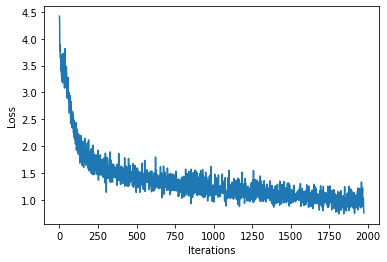

100%|██████████| 2000/2000 [00:52<00:00, 37.94it/s]


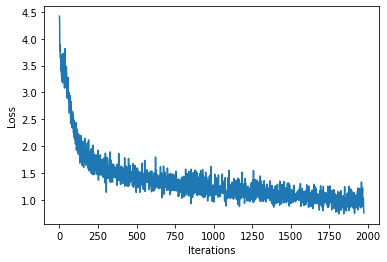

In [0]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)
optimizer = tf.keras.optimizers.Adam()

@tf.function
def train_step(x, y): 
    with tf.GradientTape() as tape:
        y_hat = model(x)
        loss = compute_loss(y, y_hat)

    grads = tape.gradient(loss, model.trainable_variables)  
    optimizer.apply_gradients(zip(grads, model.trainable_variables))
    return loss

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists

for iter in tqdm(range(num_training_iterations)):

    # Grab a batch and propagate it through the network
    x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
    loss = train_step(x_batch, y_batch)

    # Update the progress bar
    history.append(loss.numpy().mean())
    plotter.plot(history)

    # Update the model with the changed weights
    if iter % 100 == 0:     
        model.save_weights(checkpoint_prefix)
    
# Save the trained model and the weights
model.save_weights(checkpoint_prefix)


New network is created with weights created earlier - this one will have input of batch size 1 for simplicity.

In [0]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

# Restore the model weights for the last checkpoint after training
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_31"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_31 (Embedding)     (1, None, 256)            21248     
_________________________________________________________________
lstm_31 (LSTM)               (1, None, 1024)           5246976   
_________________________________________________________________
dense_31 (Dense)             (1, None, 83)             85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


Function to generate a new song.

In [0]:

def generate_text(model, start_string, generation_length=1000):

    input_eval = [char2idx[c] for c in start_string]
    input_eval = tf.expand_dims(input_eval, 0)


    text_generated = []
    model.reset_states()
    tqdm._instances.clear()

    for i in tqdm(range(generation_length)):
        predictions = model(input_eval)
        predictions = tf.squeeze(predictions, 0)
        predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
        input_eval = tf.expand_dims([predicted_id], 0)
        text_generated.append(idx2char[predicted_id])
    
    return (start_string + ''.join(text_generated))

In [0]:
generated_text = generate_text(model, start_string="Xf gfg|aba afd|dfg aga|bgf g2e|!\ndef gfe|ded dBG|cec BdB|[1 AGF G2:|", generation_length=1000)

100%|██████████| 1000/1000 [00:04<00:00, 240.98it/s]


In [0]:
### Play back generated songs ###

generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs): 
    waveform = mdl.lab1.play_song(song)

    if waveform:
        print("Generated song", i)
        ipythondisplay.display(waveform)

Found 4 songs in text
Generated song 0


Generated song 1


Generated song 2


Generated song 3


In [0]:
# Copyright 2020 MIT 6.S191 Introduction to Deep Learning. All Rights Reserved.
# 
# Licensed under the MIT License. You may not use this file except in compliance
# with the License. Use and/or modification of this code outside of 6.S191 must
# reference:
#
# © MIT 6.S191: Introduction to Deep Learning
# http://introtodeeplearning.com
#
# Program created with the help of abovementioned course